Experimental Dataset - 2D class - round2 class 93- 128x128

# Setup

In [31]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
import numpy as np
import torch
import h5py
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [32]:
print('we are here {}'.format(os.getcwd()))

we are here /gpfs/slac/cryo/fs1/g/ML/vaegan/analysis


In [33]:
KEYWORD      = 'exp_3Dclass_90x90'
KEYWORD_NINA = 'cryo_exp_3d'
EPOCH_NUMBER = 50

In [34]:
DATASET_DIR     = '../datasets/exp/20181005-rib-TEM4/Class3D/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/'
TRAINED_DIR = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+'val_cryo_exp_3d_90x90.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'class3D_90x90_sort.h5'
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+KEYWORD_NINA+'_'+TRAINED_CHECKPOINT, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)

# Load dataset, encoder and decoder

In [35]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata =  h5py.File(TRAIN_METADATASET_PATH, 'r')
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))

dataset.shape (14265, 1, 90, 90) metadata.shape (285299, 90, 90)


In [36]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

Loading encoder...
exp_3Dclass_90x90/train_vae/epoch_50_checkpoint.pth
Found checkpoint. Getting: exp_3Dclass_90x90/train_vae/epoch_50_checkpoint.pth.


(14265, 6)

In [37]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

Loading decoder...
exp_3Dclass_90x90/train_vae/epoch_50_checkpoint.pth
Found checkpoint. Getting: exp_3Dclass_90x90/train_vae/epoch_50_checkpoint.pth.


(500, 1, 90, 90)

# Visualize

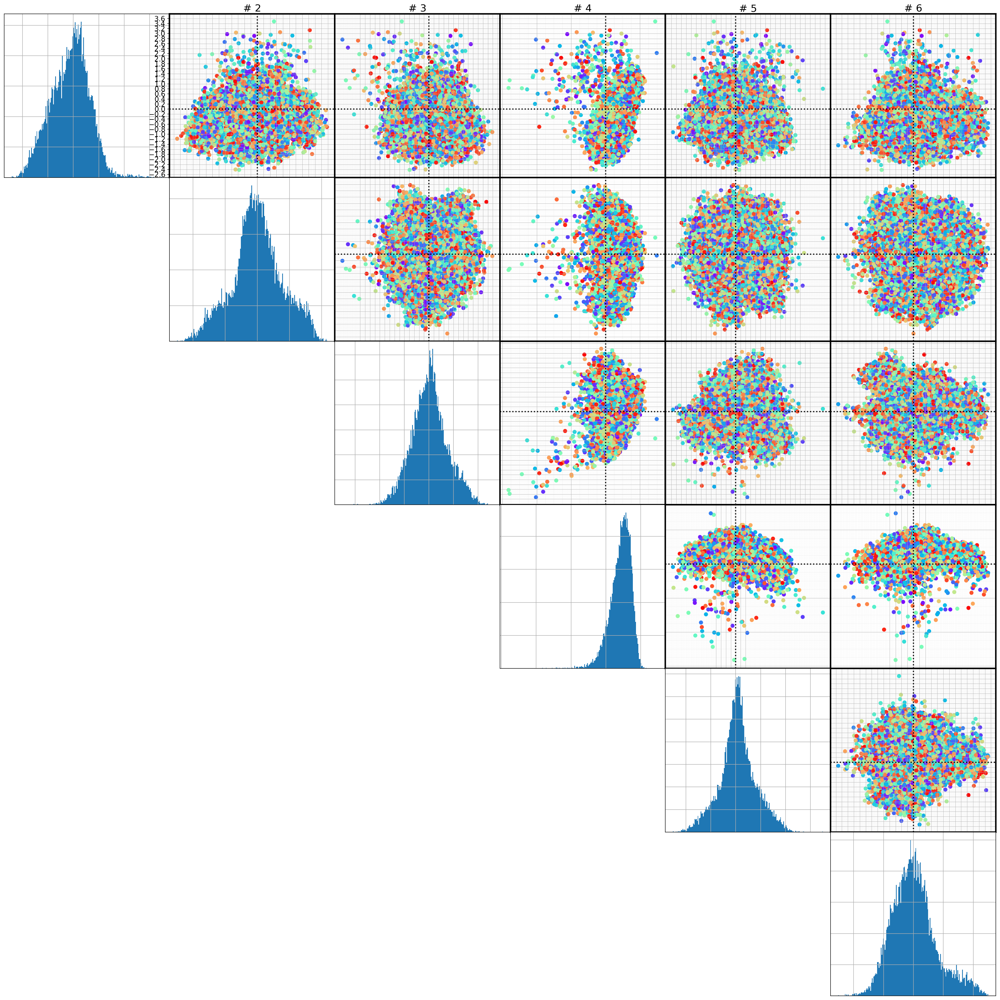

In [38]:
viz.biplots(mus, n=6, show_histo=True, nbins=200, c=np.array(metadata['_rlnanglepsi'])[0:mus.shape[0]])

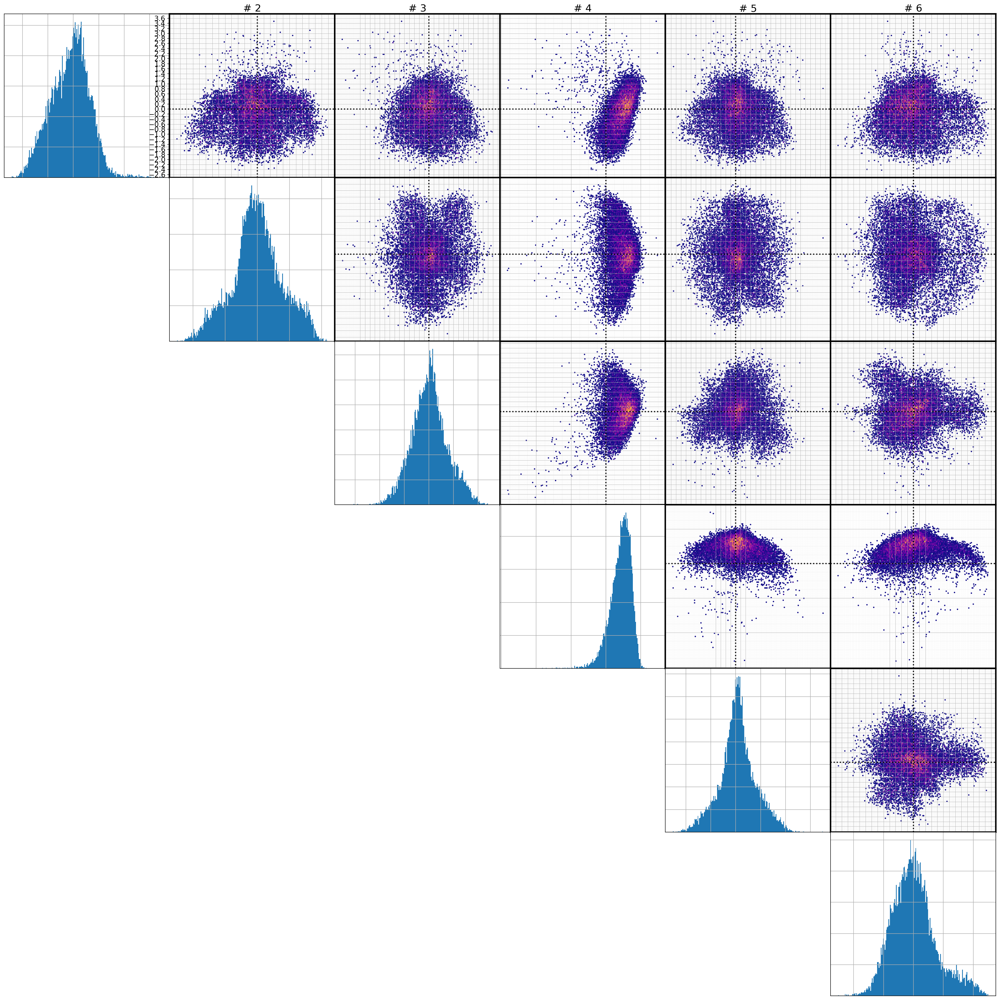

In [25]:
viz.biplots(mus, n=6, show_histo=True, nbins=200)

In [8]:
list(metadata.keys())

['_rlnamplitudecontrast',
 '_rlnanglepsi',
 '_rlnanglerot',
 '_rlnangletilt',
 '_rlnautopickfigureofmerit',
 '_rlnclassnumber',
 '_rlncoordinatex',
 '_rlncoordinatey',
 '_rlnctfbfactor',
 '_rlnctffigureofmerit',
 '_rlnctfmaxresolution',
 '_rlnctfscalefactor',
 '_rlndefocusangle',
 '_rlndefocusu',
 '_rlndefocusv',
 '_rlndetectorpixelsize',
 '_rlngroupnumber',
 '_rlnimagename',
 '_rlnloglikelicontribution',
 '_rlnmagnification',
 '_rlnmaxvalueprobdistribution',
 '_rlnmicrographname',
 '_rlnnormcorrection',
 '_rlnnrofsignificantsamples',
 '_rlnoriginx',
 '_rlnoriginy',
 '_rlnparticleselectzscore',
 '_rlnphaseshift',
 '_rlnrandomsubset',
 '_rlnsphericalaberration',
 '_rlnvoltage',
 'particles']

In [9]:
defocus_true = np.array(metadata['_rlndefocusu'])[0:mus.shape[0]]
defocus_max = 20000
defocus     = np.where(defocus_true>defocus_max,defocus_max,defocus_true)
classnumber = np.array(metadata['_rlnclassnumber'])[0:mus.shape[0]]
print(defocus.shape, classnumber.shape)
metadata_selected = np.stack((defocus, classnumber)).T
metadata_selected.shape

(14265,) (14265,)


In [12]:
Zscore = np.array(metadata['_rlnparticleselectzscore'])[0:mus.shape[0]]

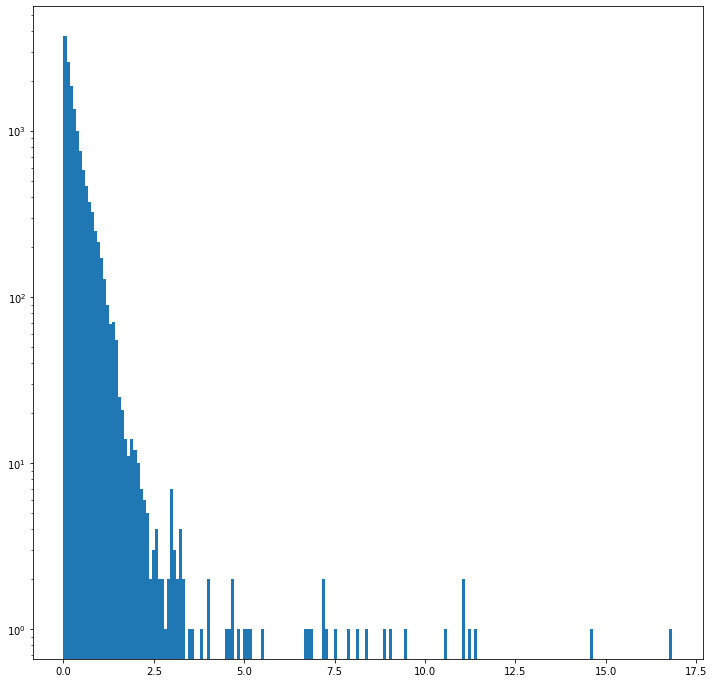

In [21]:
fig = plt.figure(figsize=(12,12))
plt.hist(Zscore, bins=200, log=True)
plt.show()

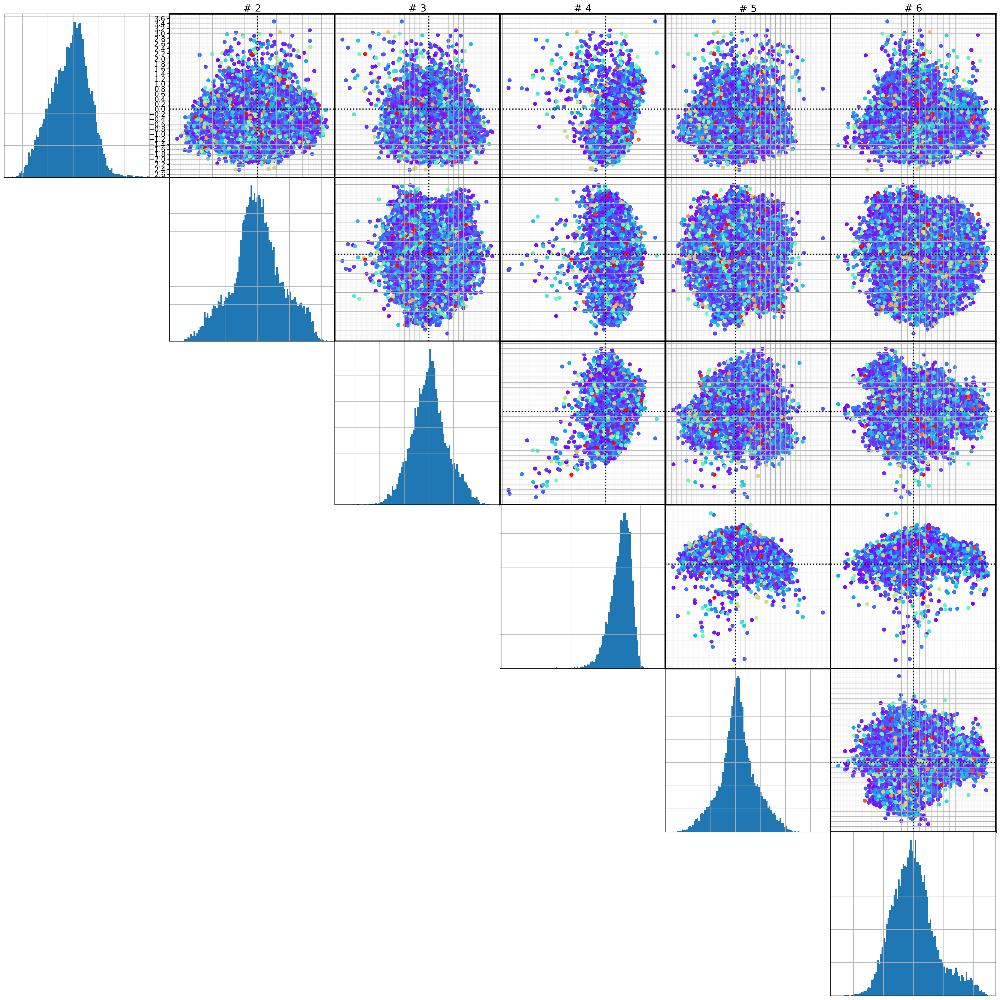

In [22]:
viz.biplots(mus, n=6, show_histo=True, nbins=100, c=np.where(Zscore>1.5,1.5,Zscore))

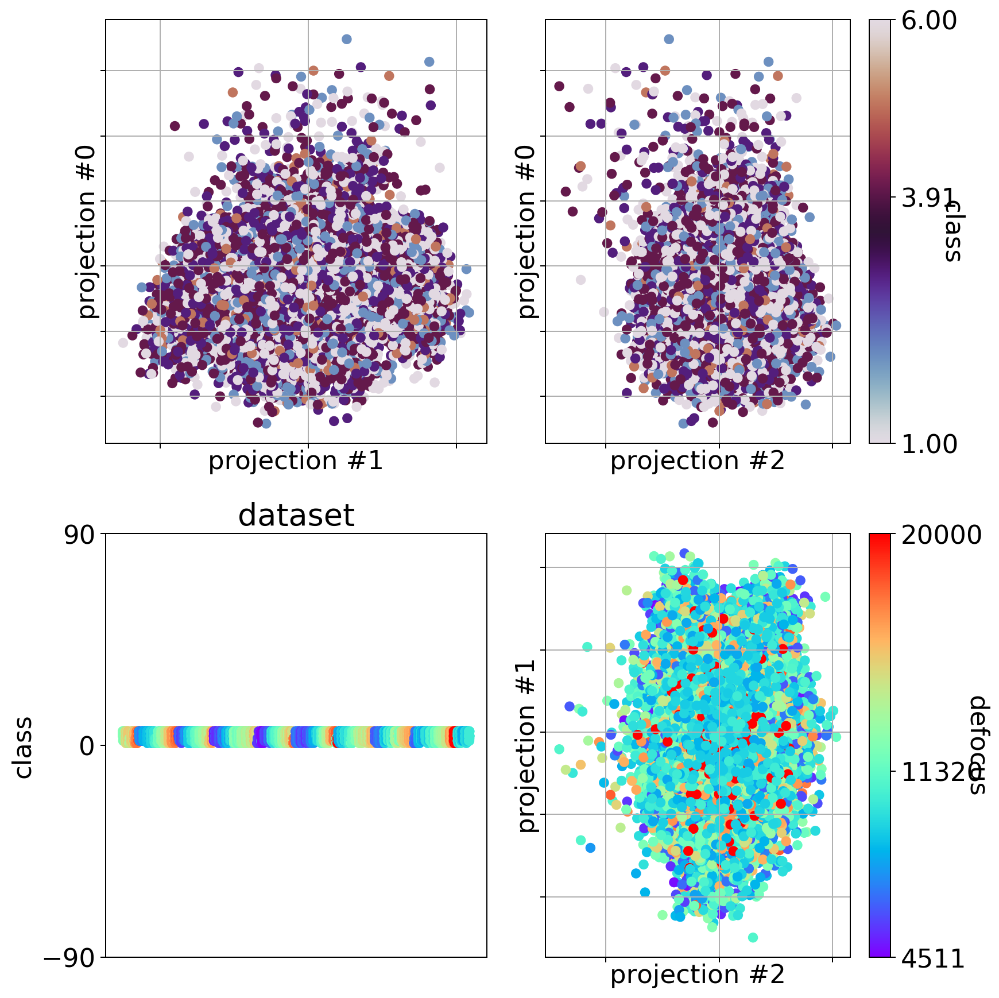

In [72]:
viz.show_latentspace(mus, metadata_selected, 
                     label0='defocus', label1='class', 
                     figsize=10, dpi=180, fontsize=18,
                     figname=KEYWORD+'/latent_space.png')

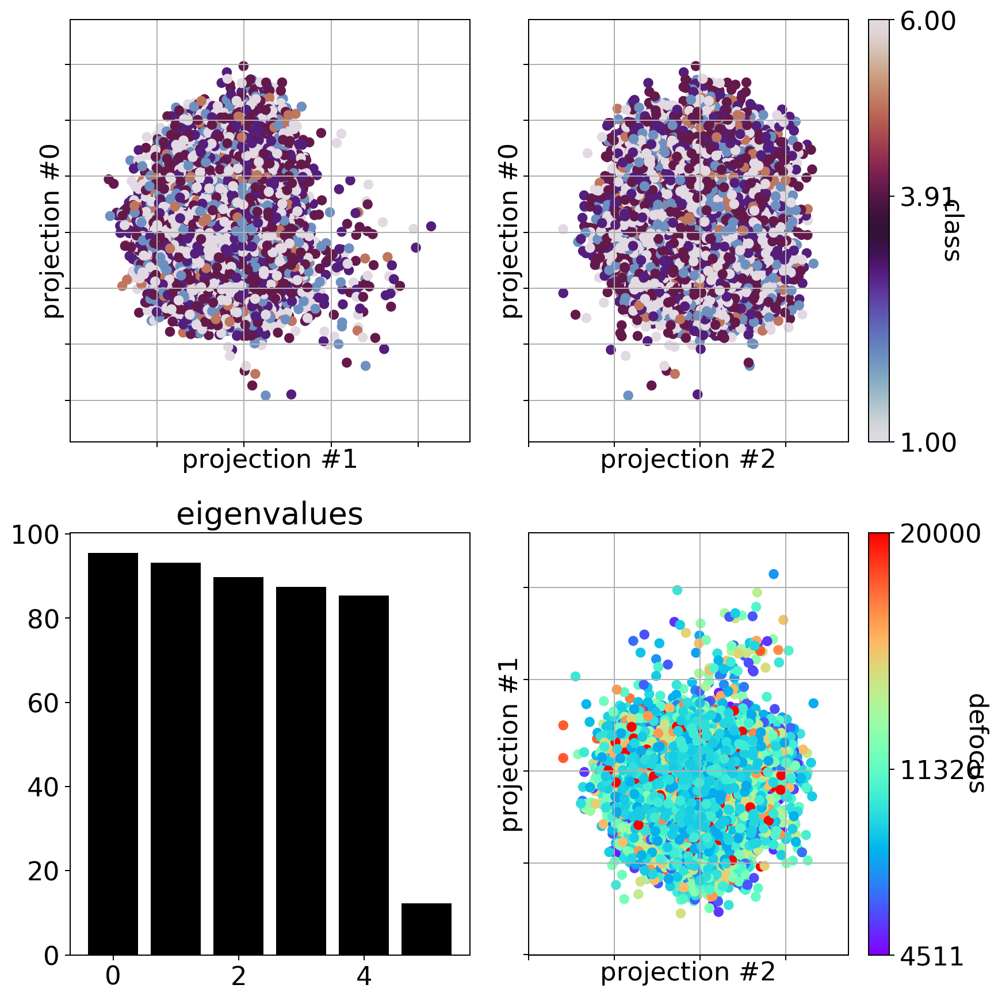

In [73]:
viz.show_latentspace(mus, metadata_selected, 
                     label0='defocus', label1='class', 
                     figsize=10, dpi=180, fontsize=18,
                     do_pca=True,
                     figname=KEYWORD+'/pca_of_latent_space.png')

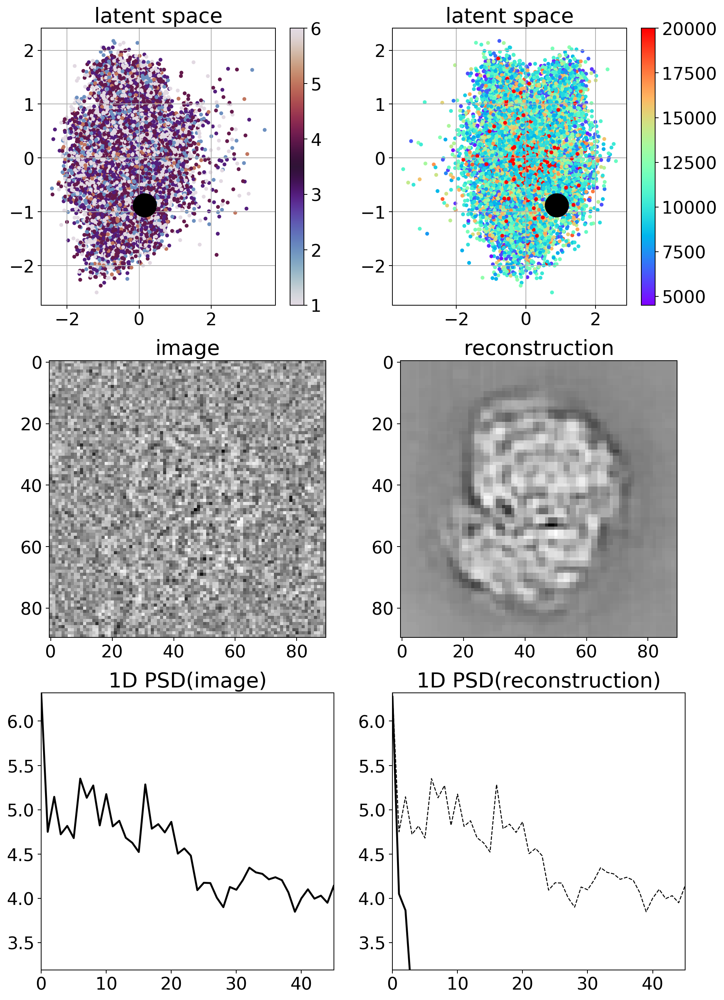

In [80]:
viz.visualize(dataset, recon,
              mus[:,0:2], mus[:,[2,1]],
              metadata_selected[:,1], metadata_selected[:,0],
              iframe=400,
              cmap1='twilight', cmap2='rainbow',
              show_3dpsd=False, show_1dpsd=True)

In [18]:
U, L, Vt = np.linalg.svd(mus, full_matrices=False)
print(U.shape, L.shape, Vt.shape)

(14265, 6) (6,) (6, 6)


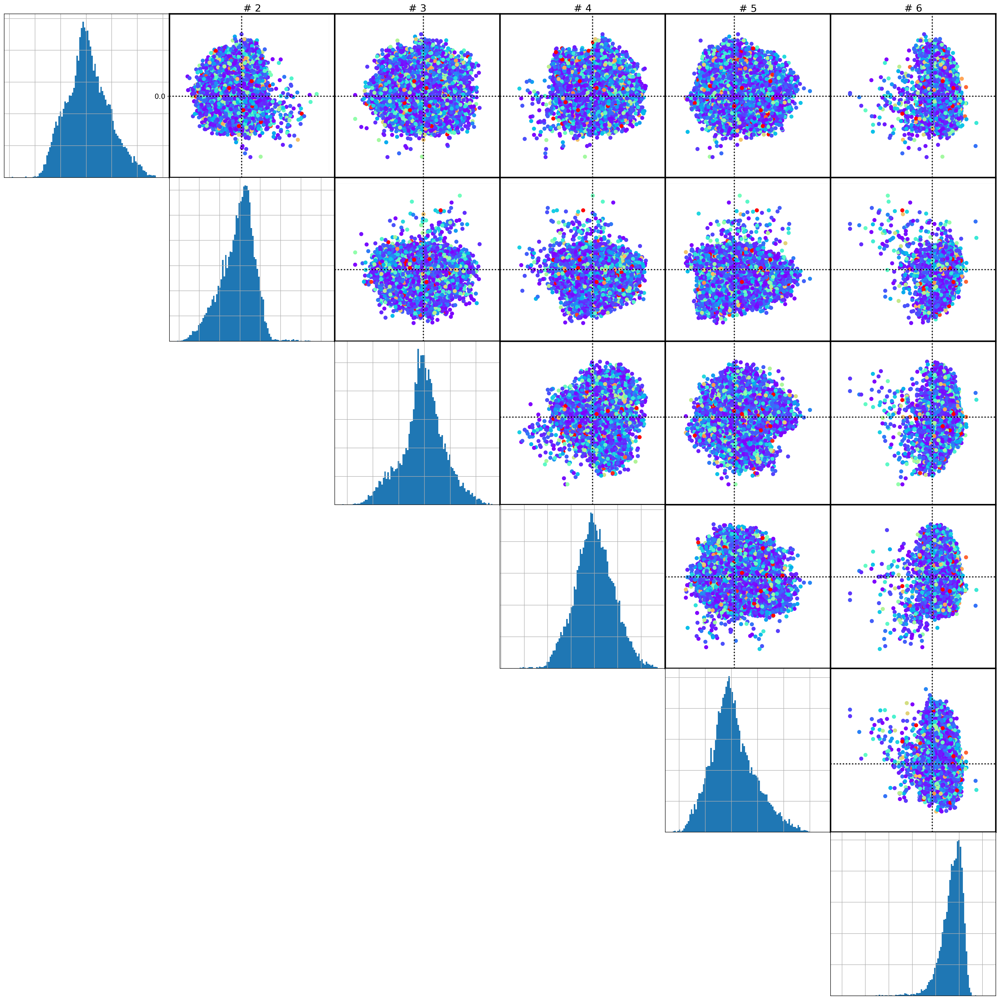

In [23]:
viz.biplots(U, n=6, show_histo=True, nbins=100, c=np.where(Zscore>1.5,1.5,Zscore))

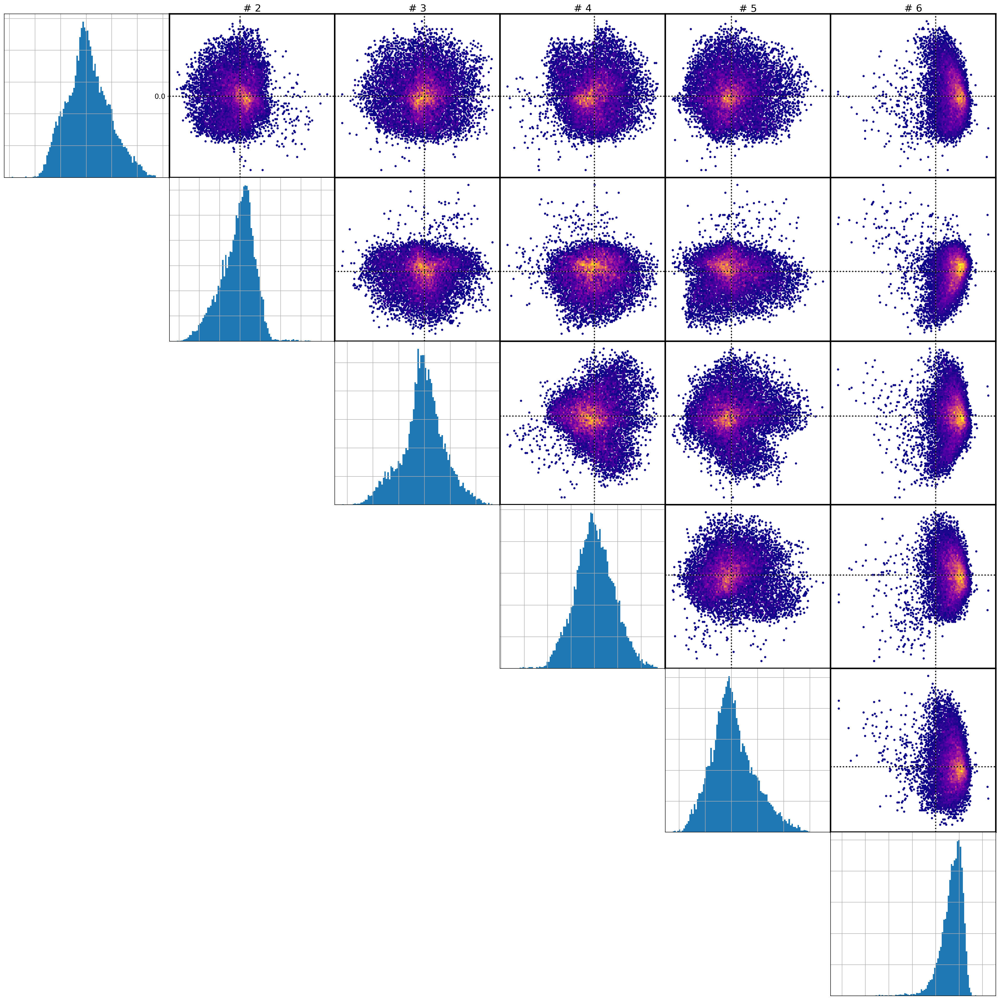

In [24]:
viz.biplots(U, n=6, show_histo=True, nbins=100)

# Correlation between features and ground truth

In [11]:
rho, theta = viz.cart2pol(mus[:,0], mus[:,1])

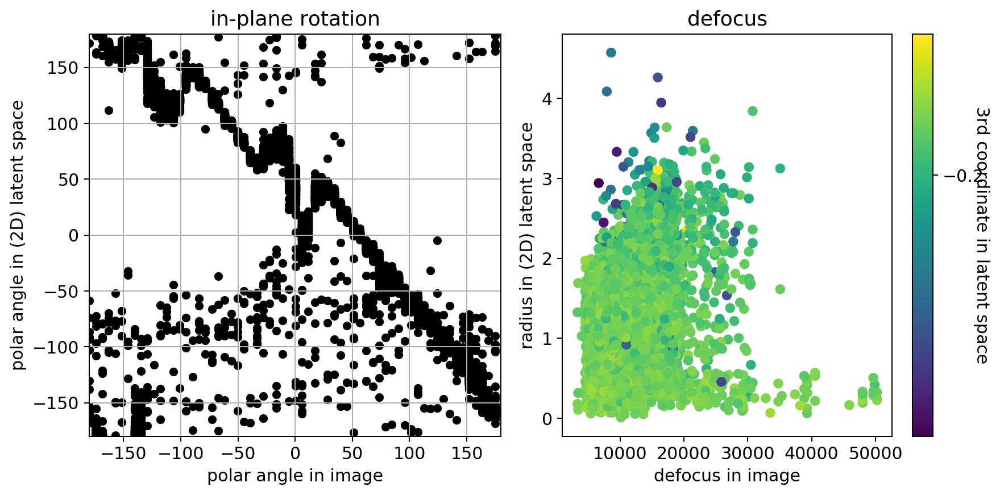

In [12]:
fig = plt.figure(figsize=(10,5), dpi=180)
plt.rcParams.update({'font.size': 12})
plt.subplot(1,2,1)
plt.title('in-plane rotation')
plt.xlabel('polar angle in image')
plt.ylabel('polar angle in (2D) latent space')
plt.xlim((-180,180))
plt.ylim((-180,180))
plt.scatter(metadata[:,1], 180*theta/np.pi, color='black', linewidths=0.1)
plt.grid()
plt.subplot(1,2,2)
plt.title('defocus')
plt.xlabel('defocus in image')
plt.ylabel('radius in (2D) latent space')
plt.scatter(metadata[:,0], rho, c=mus[:,2])
cbar = plt.colorbar(ticks=[-0.2,0.9])
cbar.set_label('3rd coordinate in latent space', rotation=270)
plt.tight_layout()
plt.show()
fig.savefig(fname=KEYWORD+'/polar_prediction')

# Outlier prediction

In [26]:
positives = np.where(Zscore<2)[0]
negatives = np.where(Zscore>2)[0]
print(positives.shape,negatives.shape)

(14167,) (98,)


robust_covar
(147,)
isolation_forest
(74,)
local_outlier_detection
(143,)


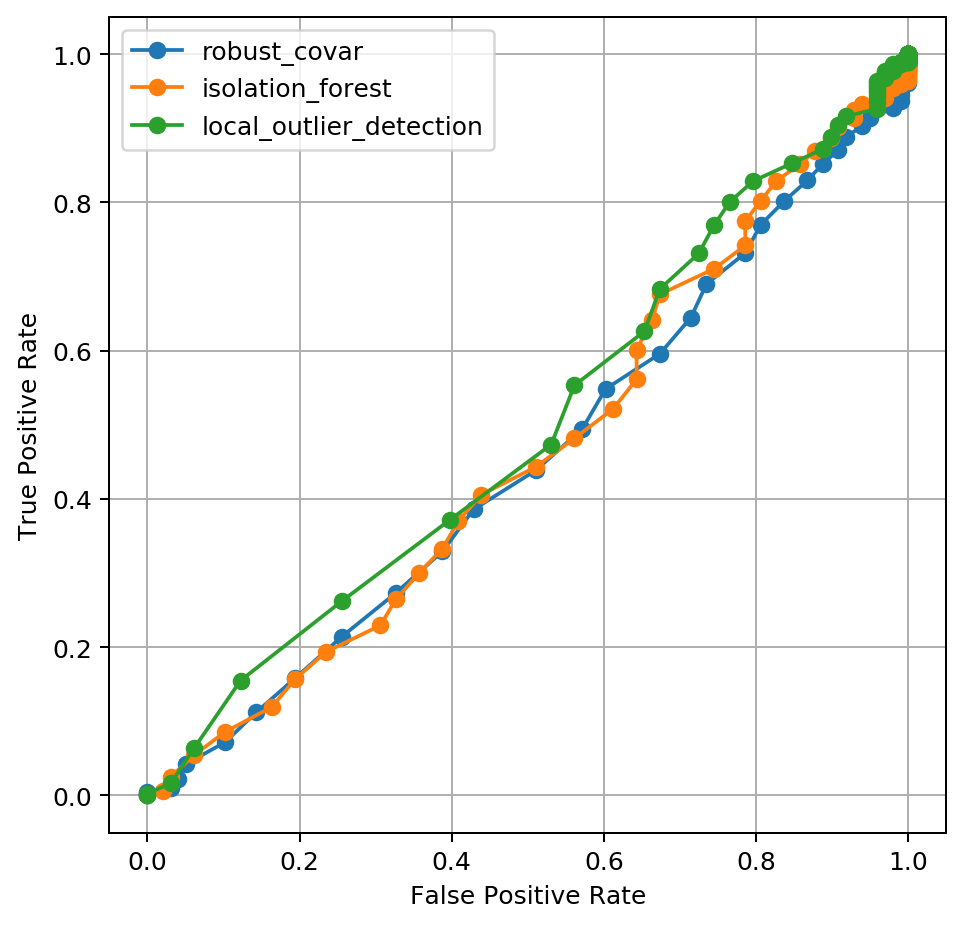

In [27]:
ROC = []
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
methods = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
for method in methods:
    print(method)
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    start = np.min(measure)
    end   = np.max(measure)+np.std(measure)/10
    step  = np.std(measure)/10
    cutoff_series = np.arange(start,end,step)
    print(cutoff_series.shape)
    ROC = np.empty((cutoff_series.shape[0],2))
    i=0
    for cutoff in np.arange(start,end,step):
        positives_pred = np.where(measure<cutoff)
        negatives_pred = np.where(measure>cutoff)
        true_positives  = np.intersect1d(positives, positives_pred)
        false_positives = np.intersect1d(negatives, positives_pred)
        TPR = true_positives.shape[0]/positives.shape[0]
        FPR = false_positives.shape[0]/negatives.shape[0]
        ROC[i,0] = FPR
        ROC[i,1] = TPR
        i+=1
    np.save(KEYWORD+'/ROC_Zscore2_'+method+'.npy', np.array(ROC))
    plt.plot(ROC[:,0],ROC[:,1], 'o-')
plt.legend(methods)
plt.grid()
plt.show()

In [28]:
measure, offset, assignment = pred.outlier_measure(mus, method='isolation_forest')

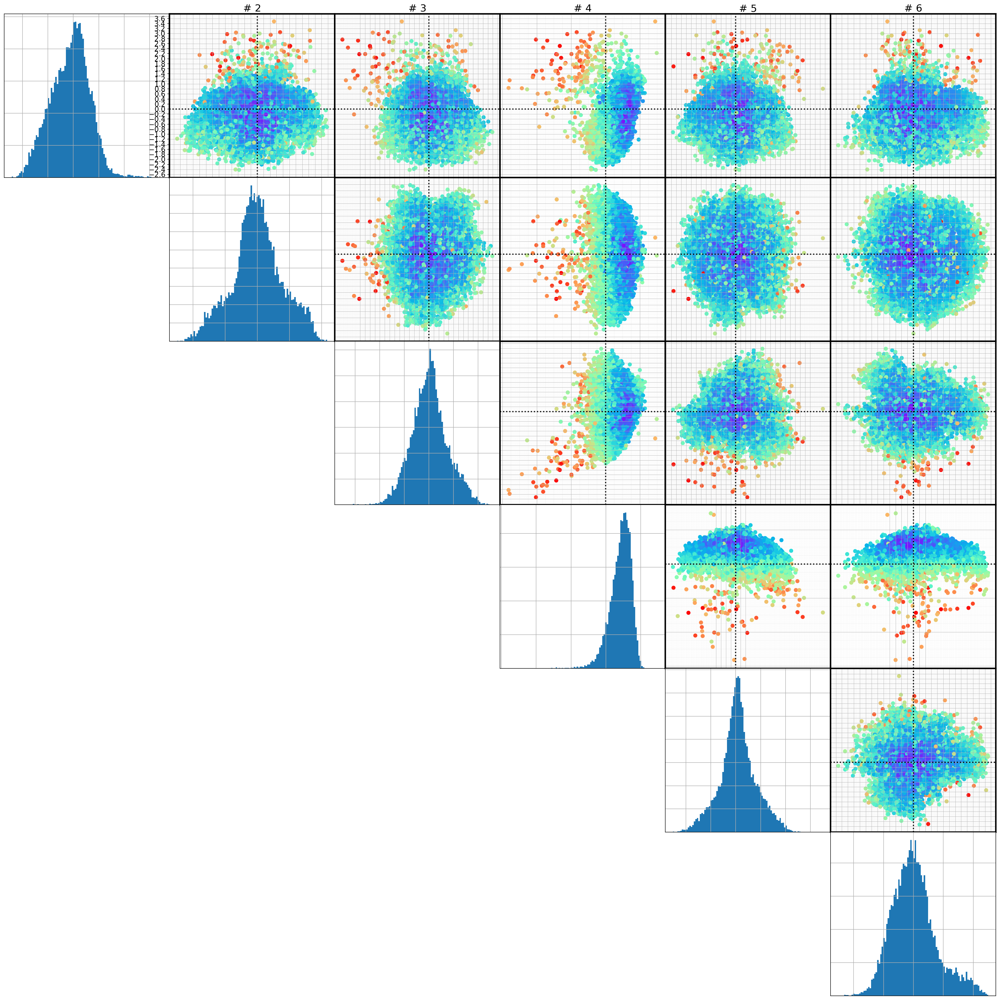

In [29]:
viz.biplots(mus, n=6, show_histo=True, nbins=100, c=measure)

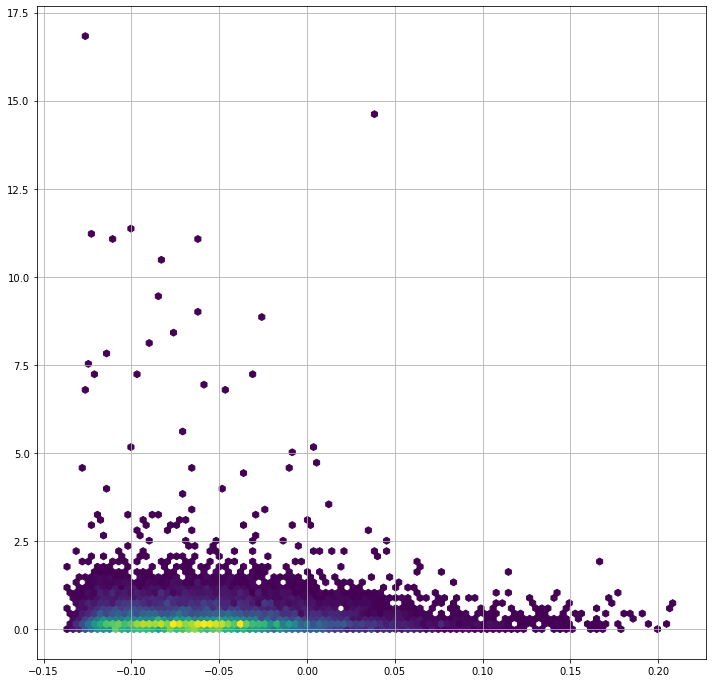

In [30]:
fig = plt.figure(figsize=(12,12))
plt.hexbin(measure-offset, Zscore, mincnt=1)
plt.grid()
plt.show()